<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Instructions**" data-toc-modified-id="Instructions**-1">Instructions**</a></span></li><li><span><a href="#Classification" data-toc-modified-id="Classification-2">Classification</a></span><ul class="toc-item"><li><ul class="toc-item"><li><span><a href="#SLM003-06/08/2018" data-toc-modified-id="SLM003-06/08/2018-2.0.1">SLM003 06/08/2018</a></span></li></ul></li></ul></li><li><span><a href="#Outline" data-toc-modified-id="Outline-3">Outline</a></span><ul class="toc-item"><li><span><a href="#Objectives" data-toc-modified-id="Objectives-3.1">Objectives</a></span></li></ul></li><li><span><a href="#What-is-&quot;classification&quot;?" data-toc-modified-id="What-is-&quot;classification&quot;?-4">What is "classification"?</a></span></li><li><span><a href="#Logistic-regression" data-toc-modified-id="Logistic-regression-5">Logistic regression</a></span></li><li><span><a href="#Fitting-a-logistic-model-using-&quot;maximum-likelihood&quot;" data-toc-modified-id="Fitting-a-logistic-model-using-&quot;maximum-likelihood&quot;-6">Fitting a logistic model using "maximum likelihood"</a></span></li><li><span><a href="#Discriminant-analysis" data-toc-modified-id="Discriminant-analysis-7">Discriminant analysis</a></span></li><li><span><a href="#Bayes'-Theorem" data-toc-modified-id="Bayes'-Theorem-8">Bayes' Theorem</a></span></li><li><span><a href="#Classification-using-discriminant-analysis" data-toc-modified-id="Classification-using-discriminant-analysis-9">Classification using discriminant analysis</a></span></li><li><span><a href="#Errors-are-not-born-equal:-Thresholding-binary-classification" data-toc-modified-id="Errors-are-not-born-equal:-Thresholding-binary-classification-10">Errors are not born equal: Thresholding binary classification</a></span></li><li><span><a href="#Choosing-classification-threshold-based-on-the-ROC-curve" data-toc-modified-id="Choosing-classification-threshold-based-on-the-ROC-curve-11">Choosing classification threshold based on the ROC curve</a></span></li><li><span><a href="#Comparison-between-different-classifiers-(reproducing-Fig-4.10,-4.11)" data-toc-modified-id="Comparison-between-different-classifiers-(reproducing-Fig-4.10,-4.11)-12">Comparison between different classifiers (reproducing Fig 4.10, 4.11)</a></span><ul class="toc-item"><li><span><a href="#Function-definitions" data-toc-modified-id="Function-definitions-12.1">Function definitions</a></span></li><li><span><a href="#Run-comparisons" data-toc-modified-id="Run-comparisons-12.2">Run comparisons</a></span></li></ul></li><li><span><a href="#Summary" data-toc-modified-id="Summary-13">Summary</a></span></li></ul></div>

# Instructions**
$\color{red}{\text{To run interactive slides, follow the instructions below}}$

On the toolbar immediately below the drop down menu, 
1. Click the ["calculator"](https://github.com/ipython-contrib/jupyter_contrib_nbextensions/tree/master/src/jupyter_contrib_nbextensions/nbextensions/init_cell) icon to run all initialization cells.
2. Click the "bar chart" icon to start slideshow. (`Alt` + `R`)

# Classification
### SLM003 06/08/2018

References:

`ISL04` James G., Witten D., Hastie T., Tibshirani R. (2013) **Classification**. In: _An Introduction to Statistical Learning_. Springer Texts in Statistics, vol 103. Springer, New York, NY. doi: https://doi.org/10.1007/978-1-4614-7138-7_4

`ESL04` Hastie T., Tibshirani R., Friedman J. (2009) **Linear Methods for Classification**. In: _The Elements of Statistical Learning_ (2nd ed.). Springer Series in Statistics. Springer, New York, NY. doi: https://doi.org/10.1007/978-0-387-84858-7_4

# Outline
1. Logistic regression
2. Discriminant analysis
  1. Linear discriminant analysis (LDA)
  2. Quadratic discriminant analysis (QDA)
  
## Objectives
- Understand the principles behind the methods
- Develop intuition of the mathematical formulation

# What is "classification"?

- **Supervised learning**: use inputs to predict output
- Classification predicts _**qualitative**_ (a.k.a. _categorical_, _discrete_) outputs
- Input: _**predictors**_ (a.k.a. _features_, _independent variables_, $X$) -- quantitative and/or qualitative
- Output: _**response**_ (a.k.a. _target_, _dependent variable_, $y$)
  - which may be refered to as different _response levels_, _targets_, _**classes**_, _categories_

# Logistic regression

Goal: Describe predictor-response relationship in the _training data_ using the **logistic model**. Make prediction using this model.

The _logistic function_ (a.k.a. _sigmoid curve_) is defined as:
$$
\require{action}
\texttip{p(X)}{predicted response} = \frac{\exp(\texttip{\beta_0}{intercept} + \texttip{\beta_1}{coefficient 1} \texttip{X_1}{predictor 1} + ... + \texttip{\beta_p}{coefficient p} \texttip{X_p}{predictor p})}{1 + \exp(\texttip{\beta_0}{intercept} + \texttip{\beta_1}{coefficient 1} \texttip{X_1}{predictor 1} + ... + \texttip{\beta_p}{coefficient p} \texttip{X_p}{predictor p})}\tag{4.6}
$$

$\mathtip{p(X)}{0 \le p(X) \le 1 \because \exp(n) \ge 1}$: predicted response  |  $X_i$: predictors  |  $\beta_i$: parameters of the model

**How to fit the model, i.e. how to determine the appropriate $\beta_i$?**

In [1]:
def logistic(x: float) -> float:
    '''Take linear, return logistic.'''
    return np.exp(x) / (1 + np.exp(x))

In [2]:
FIG_DIR = 'figures'

def figshow(fig_num: str, file_ext='png'):
    '''Display image wihtout cache'''
    import os
    import glob
    from IPython.display import HTML
    
    fig_path = glob.glob(os.path.join(FIG_DIR, fig_num) + "*." + file_ext)[0]
    display(HTML('<img src={}?{}>'.format(fig_path, np.random.randint(0,2e9))))
    
def remove_lines(axis=None, ticks=True, spines=True):
    import matplotlib.pyplot as plt
    
    if axis is None:
        axis = plt.gca()
    try:
        axis_list = axis.flat
    except:
        axis_list = [axis]
        
    for ax in axis_list:
        if ticks:
            ax.set_xticks([])
            ax.set_yticks([])
        
        if spines:
            for spine in ax.spines.values():
                spine.set_visible(0)
                
def rainbow_text(x, y, strings, colors, ax=None, **kw):
    """
    Take a list of ``strings`` and ``colors`` and place them next to each
    other, with text strings[i] being shown in colors[i].

    This example shows how to do both vertical and horizontal text, and will
    pass all keyword arguments to plt.text, so you can set the font size,
    family, etc.

    The text will get added to the ``ax`` axes, if provided, otherwise the
    currently active axes will be used.
    """
    from matplotlib import transforms
    
    if ax is None:
        ax = plt.gca()
    t = ax.transData
    canvas = ax.figure.canvas

    # horizontal version
    for s, c in zip(strings, colors):
        text = ax.text(x, y, s + " ", color=c, transform=t, **kw)
        text.draw(canvas.get_renderer())
        ex = text.get_window_extent()
        t = transforms.offset_copy(text._transform, x=ex.width, units='dots')

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from ipywidgets import interactive
from sklearn import datasets
plt.style.use('seaborn-poster')

HC = ['#e41a1c', '#377eb8', '#ff7f00', '#4daf4a', 
                  '#f781bf', '#a65628', '#984ea3',
                  '#999999', '#dede00']

# import seaborn as sns
# sns.palplot(sns.color_palette(HC))

# Fitting a logistic model using "maximum likelihood"
Focusing on binary response ($k = 2$)

In [4]:
## Load "iris" dataset
data = datasets.load_iris()
dataX1 = data.data[:,:1]  # p = 1
dataX2 = data.data[:,:2]  # p = 2
dataY2 = (data.target > 0).astype(int)  # k = 2

## Plot
def fig_maxlikelihood(page=0):
    
    fig, ax = plt.subplots(1, 2, figsize=(20,6))
    
    ax[0].set_yticks([0,1])
    ax[0].set_xlim(3, 9)    
    remove_lines(ax[1])
    ax[1].set_xlim(0, 10)
    ax[1].set_ylim(0, 10)
    
    if page >= 0:

        # Plot data
        ax[0].set_title('Training data')
        ax[0].scatter(dataX1, dataY2, s=40, marker='o', edgecolor='k', facecolor='none')
           
        ax[0].set_xlabel('x')
        ax[0].set_ylabel('y')
    
    if page >= 1:
        
        # Example model parameters to evaluate
        beta0 = -18
        beta1 = 3
        X = np.linspace(3, 9, 50)
        Y = beta0 + beta1*X
        
        # Plot model
        ax[0].plot(X, logistic(Y), c='k')
        ax[0].text(7, 0.85, r'$\haty=p(x)=\frac{\exp(\beta x)}{1+\exp(\beta x)}$', color='k', fontsize='xx-large')
        
    if page >= 2:

        # Example data point
        x = np.median(dataX1[dataY2==1])
        y = logistic(beta0 + beta1*x)
        ax[0].plot(np.repeat(x, 2), [y, 1], \
                       c=HC[0], ls='-.', lw=1, zorder=0)
        ax[0].plot(np.repeat(x, 2), [y, 0], \
                       c=HC[0], zorder=0)
        ax[0].scatter(x, y, c='k', s=40)
        ax[0].scatter(x, 1, s=40, marker='o', c=HC[0])
        
        ax[1].text(0,10, 'For a single training data point:', fontsize=20)
        ax[1].text(0,9, r'if $y_i$ = 1, model plausibility at $x_i$ = $p(x_i)$', fontsize=20, color=HC[0])  
        
    if page >= 3:

        # Example data point 2
        x = np.median(dataX1[dataY2==0])
        y = logistic(beta0 + beta1*x)
        ax[0].plot(np.repeat(x, 2), [y, 0], \
                       c=HC[1], ls='-.', lw=1, zorder=0)
        ax[0].plot(np.repeat(x, 2), [y, 1], \
                       c=HC[1], zorder=0)
        ax[0].scatter(x, y, c='k', s=40)
        ax[0].scatter(x, 0, s=40, marker='o', c=HC[1])
        
        ax[1].text(0,8, r'if $y_i$ = 0, model plausibility at $x_i$ = $1 - p(x_i)$', fontsize=20, color=HC[1]) 
        ax[1].text(1,7, 'n.b. the closer $p(x_i)$ is to 0, i.e. $y_i$, the better', fontsize=20) 
        
    if page >= 4:
        
        # Extend to all
        for x in dataX1[dataY2==1]:
            ax[0].plot(np.repeat(x, 2), [logistic(beta0 + beta1*x), 0], \
                       c=HC[0], zorder=0, alpha=0.2)
            
        for x in dataX1[dataY2==0]:
            ax[0].plot(np.repeat(x, 2), [logistic(beta0 + beta1*x), 1], \
                       c=HC[1], zorder=0, alpha=0.2)
        
        ax[1].text(0,5, 'For all training data,', fontsize=20)
        ax[1].text(0,4, 'Model plausibility, i.e. "Likelikhood":', fontsize=20)
        ax[1].text(0.5,2, r'$\mathscr{l}=$', fontsize=30)
        ax[1].text(2,2, r'$\prod_{i:y_i=1}p(x_i)$', fontsize=30, color=HC[0])
        ax[1].text(5,2, r'$\prod_{i\prime:y_{i\prime}=0}(1-p(x_{i\prime}))$', fontsize=30, color=HC[1])
        
    if page >= 5:
        
        ax[1].text(0,0, r'Model is best-fitted when $\beta$ maximises $\mathscr{l}$.', fontsize=20)
    
    plt.show()

In [11]:
interactive(fig_maxlikelihood, page=(0, 5))

interactive(children=(IntSlider(value=0, description='page', max=5), Output()), _dom_classes=('widget-interact…

# Discriminant analysis
Goal: Assign data to the most probable class based on **distribution statistics** derived from _training data_ and/or prior knowledge

# Bayes' Theorem

In [6]:
def fig_bayes(page=0):
    
    from matplotlib_venn import venn2, venn2_circles, venn3, venn3_circles
    
    fig, ax = plt.subplots(1, 2, figsize=(20,7))

    
    if page < 5:
        v_subs = venn2([6, 3, 3], set_labels=['x','y'], set_colors=['w', 'w'], ax=ax[0])
        v_subs.get_patch_by_id('11').set_color(HC[2])
        v_subs.get_patch_by_id('10').set_alpha(1)
        v_subs.get_patch_by_id('11').set_alpha(1)
        v_subs.get_patch_by_id('01').set_alpha(1)

        v_subs.get_label_by_id('10').set_text('')
        v_subs.get_label_by_id('11').set_text('')
        v_subs.get_label_by_id('01').set_text('')
        v_subs.get_label_by_id('A').set_color(HC[0])
        v_subs.get_label_by_id('B').set_color(HC[1])
        v_subs.get_label_by_id('A').set_fontsize(20)
        v_subs.get_label_by_id('B').set_fontsize(20)


        v_circ = venn2_circles([6, 3, 3], ax=ax[0])
        v_circ[0].set_edgecolor(HC[0])
        v_circ[1].set_edgecolor(HC[1])
        for circ in v_circ:
            circ.set_lw(3)
        ax[0].set_axis_on()
    
    remove_lines(ax[1])
    ax[1].set_xlim(0, 10)
    ax[1].set_ylim(0, 10)
       
    if page == 1:
        v_subs.get_patch_by_id('01').set_visible(False)
        v_subs.get_patch_by_id('11').set_color('w')
        v_subs.get_label_by_id('B').set_visible(False)
        v_circ[1].set_visible(False)
        
    if (page >=1) and (page != 2) and (page < 5):
        rainbow_text(-2.1,9, [r'$P($', r'$x$', r'$)$'], ['grey', HC[0], 'grey'], fontsize=20)
        
    if page == 2:
        ax[0].patch.set_visible(False)
        ax[0].set_axis_off()
        v_circ[1].set_ls(':')
        
    if (page >= 2) and (page < 5):
        rainbow_text(-1,9, [r'$P($', r'$y$', r'$|x)$'], [HC[0], HC[2], HC[0]], fontsize=20)
        
    if (page >= 3) and (page < 5):        
        ax[1].text(-1.2,9, r'$\cdot$', color='k', fontsize=20, va='baseline')
        
    if (page == 3) or (page == 4):
        v_subs.get_patch_by_id('10').set_visible(False)
        v_subs.get_patch_by_id('01').set_visible(False)
        v_circ[0].set_ls(':')
        v_circ[1].set_ls(':')
        
    if page == 4:
        rainbow_text(0.3,9, [r'$=$', r'$P($', r'$y$', r'$)$', r'$\cdot$', r'$P($', r'$x$', r'$|y)$'], 
                     ['k', 'grey', HC[1], 'grey', 'k', HC[1], HC[2], HC[1]], fontsize=20)
          
    if page >= 5:
        v_subs = venn3([3, 3, 3, 3, 3, 0, 0], set_labels=['x','y=$k_0$','y=$k_1$'], set_colors=['w', 'w', 'w'], ax=ax[0])
        v_subs.get_patch_by_id('101').set_color(HC[2])
        v_subs.get_patch_by_id('110').set_color(HC[4])
        v_subs.get_patch_by_id('100').set_color('none')
        v_subs.get_patch_by_id('001').set_visible(False)
        v_subs.get_patch_by_id('110').set_visible(False)
        v_subs.get_patch_by_id('010').set_visible(False)
        v_subs.get_patch_by_id('100').set_hatch('//')
        v_subs.get_patch_by_id('100').set_lw(2)
        v_subs.get_patch_by_id('100').set_edgecolor('grey')
        v_subs.get_patch_by_id('101').set_alpha(1)
        v_subs.get_patch_by_id('100').set_alpha(1)
        
        v_subs.get_label_by_id('100').set_text('')
        v_subs.get_label_by_id('110').set_text('')
        v_subs.get_label_by_id('010').set_text('')
        v_subs.get_label_by_id('101').set_text('')
        v_subs.get_label_by_id('001').set_text('')
        v_subs.get_label_by_id('A').set_color(HC[0])
        v_subs.get_label_by_id('B').set_color(HC[3])
        v_subs.get_label_by_id('C').set_color(HC[1])
        v_subs.get_label_by_id('A').set_fontsize(20)
        v_subs.get_label_by_id('B').set_fontsize(20)
        v_subs.get_label_by_id('C').set_fontsize(20)
        
        v_circ = venn3_circles([3, 3, 3, 3, 3, 0, 0], ax=ax[0])
        v_circ[0].set_edgecolor(HC[0])
        v_circ[1].set_edgecolor(HC[3])
        v_circ[2].set_edgecolor(HC[1])
        for circ in v_circ:
            circ.set_lw(3)
            circ.set_ls(':')
        
        rainbow_text(-2.9,9, [r'$P($', r'$x$', r'$)$', r'$\cdot$', r'$P($', r'$y=k_1$', r'$|x)$',
                                r'$=$', r'$P($', r'$y=k_1$', r'$)$', r'$\cdot$', r'$P($', r'$x$', r'$|y=k_1)$'], 
                     ['grey', HC[0], 'grey', 'k', HC[0], HC[2], HC[0],
                      'k', 'grey', HC[1], 'grey', 'k', HC[1], HC[2], HC[1]], fontsize=20)
        
        ax[0].set_axis_on()
        
    if page >= 6:
        
        ax[0].patch.set_visible(False)
        ax[0].set_axis_off()
        v_circ[0].set_ls('-')
        
        rainbow_text(-1.8,7.5, [r'$P($', r'$y=k_1$', r'$|x)$', r'$=$'], [HC[0], HC[2], HC[0], 'k'], fontsize=20)
    
    if page == 6:
        
        rainbow_text(0.9,8, [r'$P($', r'$y=k_1$', r'$)$', r'$\cdot$', r'$P($', r'$x$', r'$|y=k_1)$'], 
                     ['grey', HC[1], 'grey', 'k', HC[1], HC[2], HC[1]], fontsize=20)
        ax[1].text(0.9,7.8, r'$\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_$', color='k', fontsize=20, va='baseline')
        rainbow_text(2.4,7, [r'$P($', r'$x$', r'$)$'], ['grey', HC[0], 'grey'], fontsize=20)

    if page >= 7: 
        
        rainbow_text(3,8, [r'$P($', r'$y=k_1$', r'$)$', r'$\cdot$', r'$P($', r'$x$', r'$|y=k_1)$'], 
                     ['grey', HC[1], 'grey', 'k', HC[1], HC[2], HC[1]], fontsize=20)
        ax[1].text(0.9,7.8, r'$\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_$', 
                   color='k', fontsize=20, va='baseline')
        rainbow_text(0.9,7, [r'$P($', r'$y=k_0$', r'$)$', r'$\cdot$', r'$P($', r'$x$', r'$|y=k_0)$',
                             r'$+$', r'$P($', r'$y=k_1$', r'$)$', r'$\cdot$', r'$P($', r'$x$', r'$|y=k_1)$'],
                     ['grey', HC[3], 'grey', 'k', HC[3], HC[2], HC[3],
                      'k', 'grey', HC[1], 'grey', 'k', HC[1], HC[2], HC[1]], fontsize=20)
        
    if page == 8:
        
        ax[1].text(0.4,5.6, r'$=$', color='k', fontsize=20, va='baseline')
        rainbow_text(1.5,6, [r'$P($', r'$y=k_1$', r'$)$', r'$\cdot$', r'$P($', r'$x$', r'$|y=k_1)$'], 
                     ['grey', HC[1], 'grey', 'k', HC[1], HC[2], HC[1]], fontsize=20)
        ax[1].text(0.9,5.8, r'$\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_$', 
                   color='k', fontsize=20, va='baseline')
        rainbow_text(0.9,4.9, [r'$\sum\ $', r'$_{l=0}^K$', r'$P($', r'$y=k_l$', r'$)$', 
                               r'$\cdot$', r'$P($', r'$x$', r'$|y=k_1)$'], 
                     ['k', HC[4], 'grey', HC[4], 'grey', 
                      'k', HC[4], HC[2], HC[4]], fontsize=20)
        
    if page == 9:
        
        rainbow_text(-1.7,5.5, [r'$P($', r'$y=k_i$', r'$|x)$', r'$=$'], [HC[0], HC[2], HC[0], 'k'], fontsize=20)
        rainbow_text(1.5,6, [r'$P($', r'$y=k_i$', r'$)$', r'$\cdot$', r'$P($', r'$x$', r'$|y=k_i)$'], 
                     ['grey', HC[1], 'grey', 'k', HC[1], HC[2], HC[1]], fontsize=20)
        ax[1].text(0.9,5.8, r'$\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_\_$', 
                   color='k', fontsize=20, va='baseline')
        rainbow_text(0.9,4.9, [r'$\sum\ $', r'$_{l=0}^K$', r'$P($', r'$y=k_l$', r'$)$', 
                               r'$\cdot$', r'$P($', r'$x$', r'$|y=k_l)$'], 
                     ['k', HC[4], 'grey', HC[4], 'grey', 
                      'k', HC[4], HC[2], HC[4]], fontsize=20)

        ax[1].annotate('Posterior probability', xy=[0,5], xytext=(-2,3), arrowprops=dict(arrowstyle='->', lw=2), fontsize=20)
        ax[1].annotate('Class prior', xy=[2.7,4.5], xytext=(2.2,2), arrowprops=dict(arrowstyle='->', lw=2), fontsize=20)
        ax[1].annotate('Class-specific density function', xy=[5,4.5], 
                       xytext=(3,1), arrowprops=dict(arrowstyle='->', lw=2), fontsize=20)
        
    ax[0].patch.set_color('lightgrey')
    ax[0].set_ylim(-0.8, 0.8)
    ax[0].set_xlim(-0.8, 0.8)
        
    plt.show()

In [10]:
interactive(fig_bayes, page=(0,9))

interactive(children=(IntSlider(value=0, description='page', max=9), Output()), _dom_classes=('widget-interact…

**Given predictors $x$, we can determine the probability that the observation belongs to each response class $y=k_i$, if we know the probability of observing each class (_prior_), and the predictor distribution within each class (_density function_).**

# Classification using discriminant analysis
For classification, we do not need to know the posterior $P(y=k_i|x)$, we need only to know which class $k_i$ has the highest posterior, i.e. $\displaystyle\mathop{\mathrm{argmax}}_{k_i} P(y=k_i|x)$

Based on assumptions about the density function $P(x|y=k_l)$, we can define a _discriminant function_ $\delta(x)$, such that:
$$\mathop{\mathrm{argmax}}_{k}\delta_{k}(x)=\mathop{\mathrm{argmax}}_{k} P(y=k|x)$$

Assume _Gaussian_ (a.k.a. _normal_) density function,
- With **common** _predictor covariance_ $\Sigma$ shared by all classes, we can derive a _linear_ discriminant (LDA): $\delta_k(x) = \color{red}{x^T}\texttip{\Sigma}{common covariance}^{-1}\texttip{\mu_k}{class mean}-\frac{1}{2}\texttip{\mu_k}{class mean}^T\texttip{\Sigma}{common covariance}^{-1}\texttip{\mu_k}{class mean}+\log\texttip{\pi_k}{class prior}\tag{4.19}$

- With **class-specific** _predictor covariance_ $\Sigma_k$, we get a _quadratic_ discriminant (QDA): $\delta_k(x) = -\frac{1}{2}\color{red}{x^T}\Sigma_k^{-1}\color{red}{x}+\color{red}{x^T}\Sigma_k^{-1}\mu_k-\frac{1}{2}\mu^T_k\Sigma^{-1}\mu_k+\log\pi_k\tag{4.23}-\frac{1}{2}\log|\Sigma_k|$

# Errors are not born equal: Thresholding binary classification
As discussed so far, we threshold the predicted probability (both for logistic regression and for discriminant analysis) at 0.5, without distinguishing between different types of errors.

$$
\begin{array}{r|cc}
& \text{Pos} & \text{Neg}\\
\hline
\text{Predict pos} & \text{True pos} & \text{False pos}\\
& &\text{(Type I error)}\\
\text{Predict neg} & \text{False neg} & \text{True neg}\\
&\text{(Type II error)}&
\end{array}\\
\\
\text{Sensitivity, Recall} = \frac{\text{True pos}}{\text{Pos}}\qquad
\text{Specificity} = 1 - \frac{\text{False pos}}{\text{Neg}} = \frac{\text{True neg}}{\text{Neg}}\\
\text{Precision} = \frac{\text{True pos}}{\text{Predict pos}}\qquad
\text{Accuracy} = \frac{\text{True}}{\text{Total}}
$$
 (Further reading: [Wikipedia:Confusion_matrix](https://en.wikipedia.org/wiki/Confusion_matrix))

# Choosing classification threshold based on the ROC curve

In [8]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_curve

logreg_thresh = LogisticRegression()
logreg_thresh.fit(dataX1, dataY2)

# Generate ROC curve
fpr, tpr, thresh_list = roc_curve(dataY2, logreg_thresh.predict_proba(dataX1)[:,1].T)

## Plot
def fig_threshold(page=0):
    from matplotlib.patches import Patch
    
    fig, ax = plt.subplots(1, 2, figsize=(20,6))
    
    ## logistic model
    
    clf = logreg_thresh
    beta0 = clf.intercept_
    beta1 = clf.coef_
    X = np.linspace(3, 9, 50)
    Y = beta0 + beta1*X
    ax[0].plot(X, logistic(Y).T, c='k')
    ax[0].text(8, 0.85, r'$\haty=p(x)$', color='k', fontsize='xx-large')
    ax[0].set_yticks([0,1])
    ax[0].set_xlim(3, 9)    
    ax[0].set_xlabel('x')
    ax[0].set_ylabel('y')
    
    # Threshold
    threshold = thresh_list[page]
    p_hat = clf.predict_proba(dataX1)[:,1]
    y_hat = (p_hat > threshold).astype(int)
    ax[0].axhline(threshold, c=HC[5], ls=':')
    ax[0].set_title('Classification threhold: {:.2}'.format(threshold))

    # Classification accuracy
    ax[0].scatter(dataX1[(dataY2!=y_hat)&(y_hat!=1)], 
                  dataY2[(dataY2!=y_hat)&(y_hat!=1)], s=40, marker='o', c=HC[2], alpha=0.2)
    ax[0].scatter(dataX1[(dataY2==y_hat)&(y_hat==1)], 
                  dataY2[(dataY2==y_hat)&(y_hat==1)], s=40, marker='o', c=HC[3], alpha=0.2)
    ax[0].scatter(dataX1[(dataY2==y_hat)&(y_hat!=1)], 
                  dataY2[(dataY2==y_hat)&(y_hat!=1)], s=40, marker='o', c=HC[1], alpha=0.2)
    ax[0].scatter(dataX1[(dataY2!=y_hat)&(y_hat==1)], 
                  dataY2[(dataY2!=y_hat)&(y_hat==1)], s=40, marker='o', c=HC[0], alpha=0.2)
    legend_elements = [Patch(color=HC[2], label='False negative'), Patch(color=HC[3], label='True positive'),\
                       Patch(color=HC[1], label='True negative'), Patch(color=HC[0], label='False positive')]
    ax[0].legend(handles=legend_elements, loc='lower right')
    
    ## ROC curve
    
    ax[1].plot(fpr, tpr, 'k', zorder=0)
    ax[1].set_title('Receiver operating characteristic (ROC) curve')
    ax[1].set_xlabel('False positive rate = 1 - Specificity', color=HC[0])
    ax[1].set_ylabel('True positive rate = Sensitivity', color=HC[3])
    ax[1].set_xlim(-0.05, 1.05)
    ax[1].set_ylim(-0.05, 1.05)
    
    # Arrows pointing towards direction of optimisation
    ax[1].arrow(0.95, 0.95, -0.2, 0, lw=1, head_width=0.02, color=HC[0])
    ax[1].text(1, 0.85, 'Reduce Type I error', fontsize=20, ha='right', color=HC[0])
    ax[1].arrow(0.05, 0.05, 0, 0.2, lw=1, head_width=0.02, color=HC[2])
    ax[1].text(0.075, 0.1, 'Reduce Type II error', fontsize=20, color=HC[2])
    
    # Point corresponding to threshold
    ax[1].scatter(fpr[page], tpr[page], c=HC[5], zorder=1)

    plt.show()

In [12]:
interactive(fig_threshold, page=(0,len(thresh_list)-1))

interactive(children=(IntSlider(value=0, description='page', max=30), Output()), _dom_classes=('widget-interac…

# Comparison between different classifiers (reproducing Fig 4.10, 4.11)

## Function definitions

In [9]:
def gen_sample(n:int=20, cov=np.array([[[1,0],[0,1]], [[1,0],[0,1]]]), \
               response='normal', dof=3.5, beta=None):
    '''Generate samples for the different scenarios with 2 predictors
        and 2 response classes
    
    n : size of each class
    cov (k, p, p) : predictor covariance matrices for each class (k)
    response: 'normal' | 'quadratic' | 'complex'
    beta : coefficients for 'quadratic' or 'complex' response types
    '''

    k = 2
    p = 2
    
    ## Generate predictor x for each class
    X = np.empty((0,p))

    for i, covar in enumerate(cov):
        mean = i
            
        if response == 't':
            x = np.random.standard_t(dof, (n, p)) + mean
        else:
            x = np.random.multivariate_normal([mean, mean], covar, n)
            
        X = np.append(X, x, axis=0)

    ## Generate response
    
    # For the first 4 scenarios, response is simply the class
    if (response == 'normal') or (response == 't'):
        Y = np.repeat(np.arange(k, dtype=int), n)
        
    # For the last 2 scenarios, the repsonse is drawn from a distribution
    else:

        if response == 'quadratic':
            terms = np.array([np.ones((len(X),)), \
                              X[:,0], X[:,1], \
                              X[:,0]*X[:,0], X[:,1]*X[:,1], X[:,0]*X[:,1]])
            distribution = logistic(np.dot(beta[:,:len(terms)], terms)).T
            y = [np.random.normal(prob, scale=0.1) for prob in distribution]

        elif response == 'complex':
            terms = np.array([np.ones((len(X),)), \
                              X[:,0], X[:,1], \
                              X[:,0]*X[:,0]*X[:,0]*X[:,0]*X[:,0], X[:,0]*X[:,0]*X[:,0]*X[:,0]*X[:,1],\
                              X[:,0]*X[:,0]*X[:,0]*X[:,1]*X[:,1], X[:,0]*X[:,0]*X[:,1]*X[:,1]*X[:,1],\
                              X[:,0]*X[:,1]*X[:,1]*X[:,1]*X[:,1], X[:,1]*X[:,1]*X[:,1]*X[:,1]*X[:,1]])
            distribution = np.dot(beta[:,:len(terms)], terms).T
            y = [np.random.normal(prob, scale=3) for prob in distribution]
            
        Y = (y > np.median(y)).astype(int).squeeze()
        
    return X, Y

In [10]:
def score_method(train_X, train_Y, method, test_X=None, test_Y=None):
    '''Return accuracy score with particular classification method 
    using specified test and train sets.
    
    method : KNN-1 | KNN-CV | LDA | Logistic | QDA
    '''
    from sklearn.linear_model import LogisticRegression
    from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
    from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
    from sklearn.neighbors import KNeighborsClassifier
    from sklearn.model_selection import cross_val_score
    from sklearn.metrics import accuracy_score
    
    if test_X is None:
        test_X = train_X
    if test_Y is None:
        test_Y = train_Y
        
    if (method == 'KNN-1') or (method == 'KNN-CV'):
        
        if method == 'KNN-CV':
            k_range = np.arange(1,int(len(train_Y)/2))
            cv_scores = []
            for i in k_range:
                knn = KNeighborsClassifier(n_neighbors=i)
                scores = cross_val_score(knn, train_X, train_Y, scoring='accuracy')
                cv_scores.append(scores.mean())
            k = k_range[np.argmax(np.array(cv_scores))]
        
        if method == 'KNN-1':
            k = 1
        clf = KNeighborsClassifier(n_neighbors=k)
    
    elif method == 'LDA':
        clf = LinearDiscriminantAnalysis()
        
    elif method == 'Logistic':
        clf = LogisticRegression(solver='newton-cg')
        
    elif method == 'QDA':
        clf = QuadraticDiscriminantAnalysis()

    clf.fit(train_X, train_Y)
    
    return accuracy_score(test_Y, clf.predict(test_X))

In [14]:
def compare_methods(test_size=1000):
    '''For each of 6 scenarios, compare 5 classifiers, each with 100 runs.
    Generate 100 sets of samples per scenario, split each set into
    training and test data, use the same training set to train each
    classifier
    
    Return the test store for each method for each run of each scenario.
    
    test_size : size of the test set
    '''
    
    from sklearn.model_selection import train_test_split

    scores = np.zeros((6,100,5))
    
    # coefficients
    np.random.seed(1)
    beta = np.random.uniform(low=0.2, high=1, size=(1,16))*np.array([-1,1,1,-1]*4).reshape(1,-1)
    
    for s in range(6):

        # Uncorrelated predictors, unless otherwise specified
        cov = np.array([[[1,0],[0,1]], [[1,0],[0,1]]])
    
        if s < 4:
            response = 'normal'
        
            if s == 0:
                n = 20
            elif s == 1:
                n = 20
                var = 1
                cov = np.array([[[var*var, -0.5*var*var], [-0.5*var*var, var*var]],
                                [[var*var, -0.5*var*var], [-0.5*var*var, var*var]]])
            elif s == 2:
                n = 50
                response = 't'
            elif s == 3:
                n = 20
                var = 3
                cov = np.array([[[var*var, 0.5*var*var], [0.5*var*var, var*var]],
                                [[var*var, -0.5*var*var], [-0.5*var*var, var*var]]])
        else:
            if s == 4:
                n = 40  # unsure
                response = 'quadratic'
            elif s == 5:
                n = 40  # unsure
                response = 'complex'

        for j in range(100):
            
            X, Y = gen_sample(n=n+int(test_size/2), cov=cov, response=response, beta=beta)
            X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=test_size)  
            for i, method in enumerate(['KNN-1', 'KNN-CV', 'LDA', 'Logistic', 'QDA']):
                score = score_method(X_train, Y_train, method, X_test, Y_test)
                scores[s,j,i] = score
                
    return scores

In [20]:
def plot_styled(scores, page=0):
     
    colors = [HC[1], HC[1], HC[3], HC[3], HC[0]]
    scenario_summaries = ['uncorrelated random (normal)',\
                          'shared covariance', \
                          'uncorrelated random (t)',\
                          'class-specific covariance', \
                          'logistic of quadratic', \
                          'complicated non-linear']
    
    fig, ax = plt.subplots(2, 3, figsize=(20,9), sharex=True)
    
    for i, score in enumerate(scores):
        bplot = ax.flat[i].boxplot(1-score, 0, patch_artist=True)
        for patch, color in zip(bplot['boxes'], colors):
            patch.set_facecolor(color)
            patch.set_alpha(0.5)
            patch.set_linewidth(1.4)
        for point in bplot['fliers']:
            point.set_marker('.')
            point.set_markersize(5)
            point.set_markerfacecolor('k')
        for whisk in bplot['whiskers']:
            whisk.set_linestyle('--')
            whisk.set_linewidth(1)
        for m in bplot['medians']:
            m.set_color('k')
            m.set_linewidth(2)
        ax.flat[i].set_title('SCENARIO {}\n{}'.format(i+1, scenario_summaries[i]))
        ax.flat[i].set_xticklabels(['KNN-1', 'KNN-CV', 'LDA', 'Logistic', 'QDA'])
        
        
    if page >=1:
        ax.flat[0].annotate('LDA>QDA: overfiting', xy=(3.2,0.28), xytext=(3.5, 0.45), \
                            arrowprops=dict(arrowstyle='->', lw=2), fontsize=20, ha='center')
        ax.flat[0].annotate('LDA>QDA: overfiting', xy=(4.8, 0.3), xytext=(3.5, 0.45), \
                            arrowprops=dict(arrowstyle='->', lw=2), fontsize=20, ha='center')      
    
    plt.show()

## Run comparisons

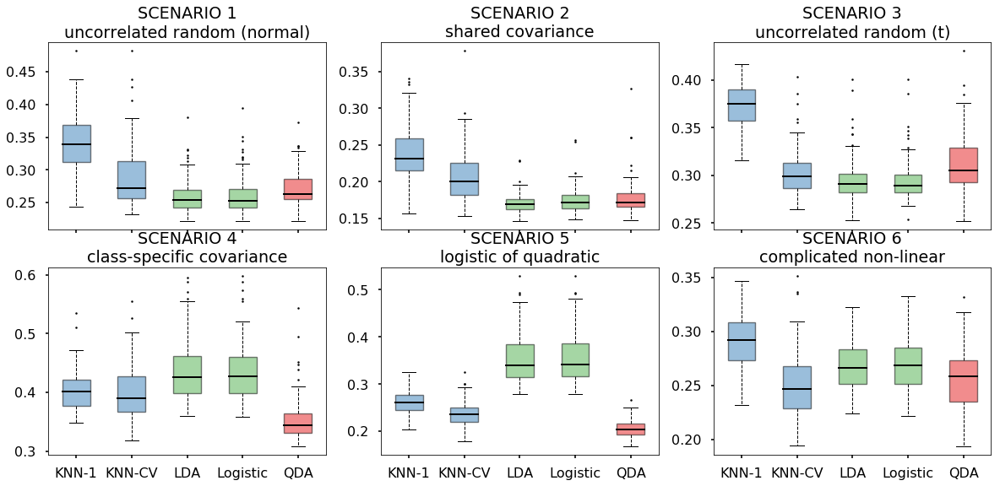

CPU times: user 16min 51s, sys: 25 s, total: 17min 17s
Wall time: 1min 49s


In [21]:
%%time
scores = compare_methods(test_size=2000)
plot_styled(scores)

# Summary

- Linear decision boundary:
    - Logistic Regression: model each binary decision using a logistic form of _linear_ regression, predict the binary response probability
    - LDA: model predictor distributions of each class as _Gaussian_, then based on Bayes' Theorem, compare to see which response is more probable
        - More stable than logistic regression when classes are well-separated
        - If Guassian assumption is valid, more stable than logistic regression when sample size is small
- Non-linear decision boundary:
    - QDA: same as LDA, but allow each class to have _different predictor covariances_
        - More suitable for fitting non-linear decision boundary, but risk overfitting if true boundary is linear